In [1]:
import tensorflow as tf
import numpy as np
import tensorflow.keras as keras
import tensorflow_datasets as tfds
from keras import Model, layers
from tensorflow.keras import initializers

import imageio as iio
import pickle
import random
import os
import re
from tqdm import tqdm
from PIL import Image
from matplotlib import cm
from matplotlib import pyplot as plt
from mini_lucid_tf2 import objectives, transformations, render


# Select whether Angle or Power shall be loaded
angle = True
closed = True
domain = "_A_" if angle else "_P_" 
print_domain = "Phase" if angle else "Power" 
condition = "_closed" if closed else "_open" 

# Select whether 32 channel or P8 data shall be predicted
p8 = True


# Load and transform data
The numpy arrays of training and testing volumes are transformed to tensorflow Datasets and batched. To free memory, the numpy arrays used to build the tensorflow datasets are deleted to free memory. 

In [2]:
# Load data according to if p8 data or 32 channel data shall be classified

if p8:
    os.chdir('/home/bpn/Documents/Max/P8_final')
    
    # Load P8 Data
    p8_train = np.load("Data/p8_train%s%s.npy"%(domain, condition))
    p8_test = np.load("Data/p8_test%s%s.npy"%(domain, condition))

    p8_train_pics = []
    p8_test_pics = []

    # With this function, the P8 slices are transformed to RGB images. 
    # Angle matrices are min-max scaled (min value = 0 and max value = 1), as required to convert it to RGB. 
    # Both Angle and Phase matrices are then multiplied by 255 to fit the scale of RGB images
    def tensor_to_pic(tensor_list, angle, empty_list):
        for matrix in tqdm(tensor_list):
            if angle:
                transmat = (matrix - matrix.min()) / (matrix.max() - matrix.min())
                im = Image.fromarray(np.uint8(np.round(cm.twilight(transmat)*255))).rotate(180)
            else:
                im = Image.fromarray(np.uint8(cm.magma(matrix)*255)).rotate(180)
            pic = np.array(im)[:,:,:3] # Select RGB channels
            empty_list.append(pic/255)

        return empty_list

    # Applying the function
    p8_train_pics = tensor_to_pic(p8_train, angle, p8_train_pics)
    p8_test_pics = tensor_to_pic(p8_test, angle, p8_test_pics)

    train_targets = np.load("Data/target_train%s%s.npy"%(domain, condition))
    test_targets = np.load("Data/target_test%s%s.npy"%(domain, condition))
    
    def pics_to_datasets(picture_list, target_list, batch_size, batch_to_load = 10):   
    
        dataset = tf.data.Dataset.from_tensor_slices((picture_list[0:2], target_list[0:2]))
        for i in tqdm(range(2,len(picture_list), batch_to_load)):
            temp_dataset = tf.data.Dataset.from_tensor_slices((picture_list[i:(i+batch_to_load)], target_list[i:(i+batch_to_load)]))
            dataset = dataset.concatenate(temp_dataset) 

        # Batch subset
        dataset = dataset.batch(batch_size)

        return dataset

    batch_size = 32
    trainset = pics_to_datasets(p8_train_pics, train_targets, batch_size, 25)
    testset = pics_to_datasets(p8_test_pics, test_targets, batch_size, 25)

    
else:
    os.chdir('/home/bpn/Documents/Max/32_channels')
    
    # Load 32-channel Tensors
    train_tensors = np.load("Data/32_train%s%s.npy"%(domain, condition))
    test_tensors = np.load("Data/32_test%s%s.npy"%(domain, condition))
    train_targets = np.load("Data/target_train%s%s.npy"%(domain, condition))
    test_targets = np.load("Data/target_test%s%s.npy"%(domain, condition))

    # Here the numpy arrays are transformed to tensorflow Datasets for easier handling during training.
    # This is done in batches to play it easy on memory, kernel timed  out sometimes when loading all data at once
    def pics_to_datasets(picture_list, target_list, batch_size, batch_to_load = 10):   

        dataset = tf.data.Dataset.from_tensor_slices((picture_list[0:2], target_list[0:2])) # Instantiate dataframe with first two pics / targets
        for i in tqdm(range(2,len(picture_list), batch_to_load)):
            temp_dataset = tf.data.Dataset.from_tensor_slices((picture_list[i:(i+batch_to_load)], target_list[i:(i+batch_to_load)]))
            dataset = dataset.concatenate(temp_dataset) 

        # Batch dataset
        dataset = dataset.batch(batch_size)

        return dataset

    # Apply function and then get rid of the arrays from which data is loaded in the dataframes, in order to save memory
    batch_size = 32
    trainset = pics_to_datasets(train_tensors, train_targets, batch_size, 10)
    del train_tensors, train_targets # Delete tensors to free memory
    gc.collect() # Free memory
    testset = pics_to_datasets(test_tensors, test_targets, batch_size, 10)
    del test_tensors, test_targets # Delete tensors to free memory
    gc.collect() # Free memory
    

100%|██████████████████████████████████████| 1898/1898 [00:06<00:00, 313.00it/s]
2022-03-29 12:37:09.106283: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-03-29 12:37:09.519154: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 21944 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:17:00.0, compute capability: 8.6
100%|███████████████████████████████████████████| 76/76 [00:42<00:00,  1.79it/s]


## Display sample picture

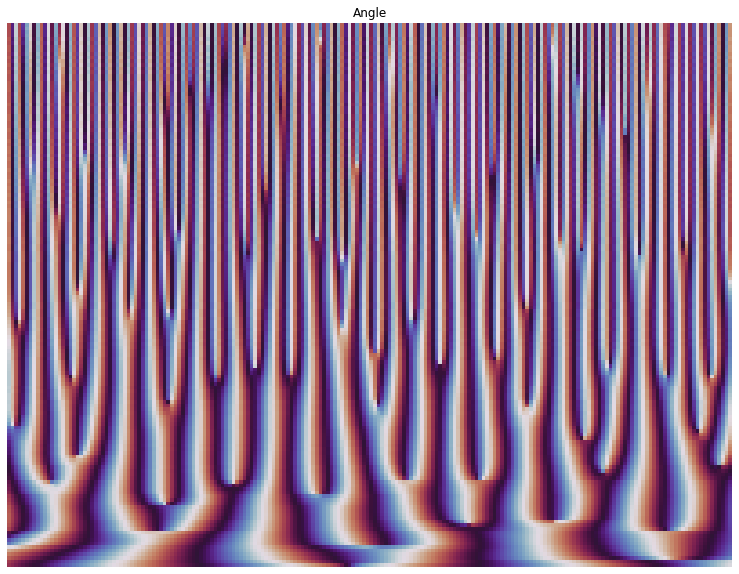

In [3]:
fig, ax = plt.subplots(1, 1, figsize = (20,10))
ax.set_title("Angle")
ax.axis('off')
ax.imshow(p8_train_pics[0])
plt.show()

# Modeling

In this step, the ResNet-50 is configured (i.e., layers frozen, weights loaded,...) and the model's paramters are specified (Learning Rate, Dropout, Optimizer, Regularization, Weight initialization). Then, the model is trained with the AUC and the accuracy as metrics to monitor during training. A best model is saved each time a new highest validtion AUC is achieved during training (with the ModelCheckpoints callback). Additionally, training can be stopped when an training AUC of 1 is reached, as this indicates overfitting (--> overfit_callback; not applied for the analysis reported in the thesis).

In [7]:
## Self-trained ResNet50

# Initialize ResNet50 without top, to allow classification of 32 channel images. 
resnet = tf.keras.applications.resnet50.ResNet50(include_top=False, weights="imagenet")

# Uncomment if parts of the ResNet shall be non-trainable.
# By indexing the layers, parts of the model can be frozen an only later layer can be trained
#for layer in resnet.layers[:10]: # Freeze first 10 layers
#        layer.trainable=False
        
    
## Build the ResNet Model architecture
x = resnet.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.3)(x) # Apply dropout before fully-connected layer
x = layers.Dense(256, activation='relu')(x) 
predictions = layers.Dense(1, activation='sigmoid')(x)
viz_model = Model(resnet.input, predictions)

# Function to add regularization onyl to layers that are trainable
def add_deep_regularization(model, regularizer, initializer):
    
    for layer in model.layers:
        
        resnet_names = [rl.name for rl in model.layers]
        
        # Regularize only those layers that are trainable (not frozen ones)
        if layer.trainable == True:
            for attr in ['kernel_regularizer']:
                if hasattr(layer, attr):
                    setattr(layer, attr, regularizer)
        
        # Initialize only those layers that are not included in ResNet
        if layer.name not in resnet_names:
            for attr in ['kernel_initializer']:
                if hasattr(layer, attr):
                    setattr(layer, attr, initializer)

    # When we change the layers attributes, the change only happens in the model config file
    model_json = model.to_json()
    model = tf.keras.models.model_from_json(model_json)
    
    return model

viz_model = add_deep_regularization(viz_model, 
                               regularizer = tf.keras.regularizers.l2(0.01),
                               initializer = keras.initializers.RandomNormal(stddev = 1.0))

adam = keras.optimizers.Adam(learning_rate=1e-05)

viz_model.compile(optimizer=adam, loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC(from_logits=True, name = 'AUC'), 'accuracy'])


Epoch 1/100
87/87 [==============================] - 15s 121ms/step - loss: 184.9579 - AUC: 0.5291 - accuracy: 0.5479 - val_loss: 183.6284 - val_AUC: 0.5000 - val_accuracy: 0.6154
Epoch 2/100
87/87 [==============================] - 9s 103ms/step - loss: 182.4761 - AUC: 0.5451 - accuracy: 0.5634 - val_loss: 181.1736 - val_AUC: 0.4883 - val_accuracy: 0.6154
Epoch 3/100
87/87 [==============================] - 10s 117ms/step - loss: 180.0045 - AUC: 0.6029 - accuracy: 0.6009 - val_loss: 178.8541 - val_AUC: 0.5025 - val_accuracy: 0.6154
Epoch 4/100
87/87 [==============================] - 9s 104ms/step - loss: 177.5697 - AUC: 0.6721 - accuracy: 0.6435 - val_loss: 176.5540 - val_AUC: 0.4822 - val_accuracy: 0.6154
Epoch 5/100
87/87 [==============================] - 10s 115ms/step - loss: 175.1318 - AUC: 0.8044 - accuracy: 0.7296 - val_loss: 174.6590 - val_AUC: 0.5067 - val_accuracy: 0.6154
Epoch 6/100
87/87 [==============================] - 10s 113ms/step - loss: 172.6538 - AUC: 0.9553 - a

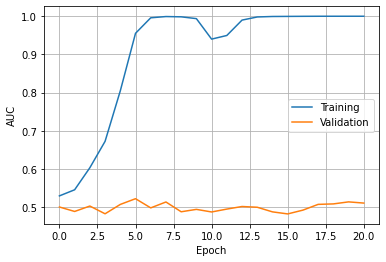

In [8]:

# Define Callbacks
class myCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        if(logs.get('AUC') == 1.0):
            print("\nReached AUC of 1 so cancelling training!")
            self.model.stop_training = True
            
overfit_callback = myCallback()

checkpoints = tf.keras.callbacks.ModelCheckpoint('Models/ResNet_bestmodel_{}{}.h5'.format(domain, condition), 
                                                 monitor='val_AUC', 
                                                 save_best_only=True,
                                                 mode = 'max') # Mode = 'max' is important, otherwise the model with the lowest AUC is saved
callbacks_list = [overfit_callback, checkpoints]

# Train Model
trainHistory = viz_model.fit(trainset,
                             batch_size = batch_size, 
                             epochs=100, 
                             callbacks = callbacks_list, 
                             validation_data=testset)

# Plot Train and validation AUCs
plt.plot(trainHistory.history['AUC'])
plt.plot(trainHistory.history['val_AUC'])
plt.ylabel('AUC')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'])
plt.grid()
plt.show()
 

In [ ]:
os.chdir('/home/bpn/Documents/Max/ResNet_50')

# Save Model
viz_model.save('ResNet_{}{}'.format(domain, condition))

# Save TrainHistory
with open('ResNet_trainHistory_{}{}.pkl'.format(domain, condition), 'wb') as f:
    pickle.dump(trainHistory, f)


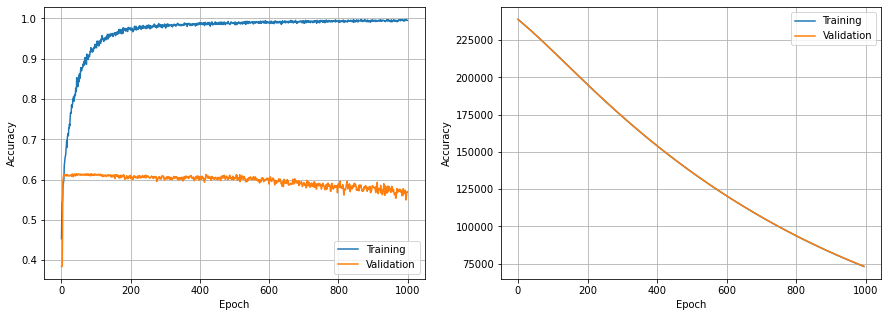

In [15]:
fig, ax = plt.subplots(1,2,figsize = (15,5))

ax[0].plot(trainHistory.history['accuracy'])
ax[0].plot(trainHistory.history['val_accuracy'])
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epoch')
ax[0].legend(['Training', 'Validation'])
ax[0].grid()
ax[1].plot(trainHistory.history['loss'][5:])
ax[1].plot(trainHistory.history['val_loss'][5:])
ax[1].set_ylabel('Accuracy')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Training', 'Validation'])
ax[1].grid()

plt.show()


## ROC-Curve and Confusion Matrix

In [10]:
# Load best Model from Training procedure
viz_model = keras.models.load_model('Models/ResNet_bestmodel_{}{}.h5'.format(domain, condition))

# Predict with best-trained Model
model_predictions = viz_model.predict(testset)

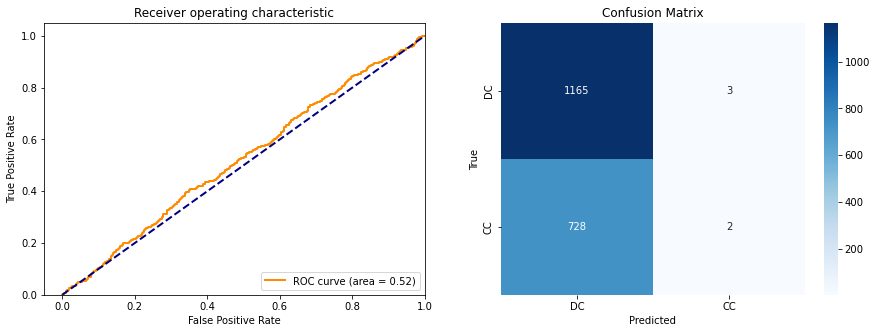

In [11]:
# Build arrays for GradCAM and predictions to inspect the network's decision making

from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
import seaborn as sns

test_targets = np.load("Data/target_test%s%s.npy"%(domain, condition))

pred = [i[0] for i in model_predictions] # Extract logits from model prediction (every logit is in a single array)
fpr, tpr, _ = roc_curve(test_targets, pred)# Compute False positive and true positive rate
roc_auc = auc(fpr, tpr) #Compute AUC

# Plot AUC and Confusion Matrix next to each other
fig, ax = plt.subplots(1,2,figsize = (15,5))

# Plot AUC
lw = 2 #linewidth
ax[0].plot(
    fpr,
    tpr,
    color="darkorange",
    lw=lw,
    label="ROC curve (area = %0.2f)" % roc_auc,
)

ax[0].plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
ax[0].set_xlim([-0.05, 1.0])
ax[0].set_ylim([0.0, 1.05])
ax[0].set_xlabel("False Positive Rate")
ax[0].set_ylabel("True Positive Rate")
ax[0].set_title("Receiver operating characteristic")
ax[0].legend(loc="lower right")

# Confusion Matrix
predictions = [round(i[0]) for i in model_predictions] #Round model predictions to 0 and 1
confmat = confusion_matrix(test_targets, predictions) # Build Confusion Matrix

#Plot Confusion Matrix
ax[1] = sns.heatmap(confmat, annot=True, fmt="d", cmap = "Blues", xticklabels = ["DC","CC"], yticklabels = ["DC","CC"])
ax[1].set_ylabel("True")
ax[1].set_xlabel("Predicted")
ax[1].set_title("Confusion Matrix")

plt.show()
   

# ResNet Tuning

This cell provides code to tune a ResNet's Hyperparameters. The Hyperparameters are specified in lists, and the results of each parameter combination is printed at the end. Furthemore, the trainHistories of the single training processes are stored in list for later inspection

In [ ]:

batch_size = 32
epoch_number = 500

# Specify the hyperparameters to be investigated
lr = [1e-2, 1e-4, 1e-6]
reg = [1e-1, 1]
dropout = [0.1, 0.3, 0.5]
layers_to_freeze = [10,20]

# Early Stopping Callback when the loss does not decrease for 20 epochs
minchange_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=20, min_delta = 0.001)

# Empty list to store trainHistories in
trainHistories = []

# Build Parameter grid based on the previously defined lists
from sklearn.model_selection import ParameterGrid
param_grid = ParameterGrid({'lr': lr, 'reg': reg, 'dropout': dropout, 'layers_to_freeze': layers_to_freeze})

# Iterate over parameters in parameter grid
for params in param_grid:
    
    # Initialize ResNet50
    resnet = tf.keras.applications.resnet50.ResNet50(include_top=False, weights="imagenet")

    # Freeze number of layers as specified in the parameter grid
    for layer in resnet.layers[:params['layers_to_freeze']]:
        layer.trainable = False


    ## Build the viz model architecture
    x = resnet.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dropout(params['dropout'])(x) # Dropout as in parameter grid
    x = layers.Dense(256, activation='relu')(x) 
    predictions = layers.Dense(1, activation='sigmoid')(x)
    viz_model = Model(resnet.input, predictions)

    viz_model = add_deep_regularization(viz_model, 
                                   initializer = keras.initializers.RandomNormal(stddev = 1.0), 
                                   regularizer = tf.keras.regularizers.l2(params['reg'])) # Regularization as in parameter grid

    adam = keras.optimizers.Adam(learning_rate=params['lr']) # Learnign rate as in parameter grid
    viz_model.compile(optimizer=adam, 
                      loss='binary_crossentropy', 
                      metrics=[tf.keras.metrics.AUC(from_logits=True, name = 'AUC'), 'accuracy'])
    
    trainHistory = viz_model.fit(trainset, batch_size = batch_size, epochs=epoch_number, validation_data=testset, callbacks = [minchange_callback], verbose = 0)
    
    trainHistories.append(trainHistory)
    print("LR: {}, Regularization: {}, Dropout: {}, Frozen Layers: {}, Train AUC: {}, Val AUC: {}".format(params['lr'],
                                               params['reg'],
                                               params['dropout'],
                                               params['layers_to_freeze'],
                                               np.mean(trainHistory.history['AUC'][-5:-1]), # Mean over last 5 AUC values
                                               np.mean(trainHistory.history['val_AUC'][-5:-1]))) # Mean over last 5 AUC values

In [ ]:
# Cell to eventually store the trainhistories from Hyperparameter Tuning

with open('deep_tuning.pkl', 'wb') as f:
    pickle.dump(trainHistories, f)
    

# Attention: All visual interpretation only applicable if classifying P8 data! The code will crash if 32-channel data is being classified and visualization through Grad-CAM or Lucid is tried

# Grad-CAM

In [12]:
# Load best Model from Training procedure
viz_model = keras.models.load_model('Models/ResNet_bestmodel_{}{}.h5'.format(domain, condition))

# Get the name of the last convolutional layer
for layer in viz_model.layers[::-1]: # Iterate through reversed layers
    if 'conv' in layer.name: # The name of the first (i.e., last, due to layer reversal) layer to contain "conv" in name breaks the loop 
        last_conv_layer_name = layer.name
        break

Display an image of power / phase, the corresponding heatmap, as well as the Heatmap superimposed on top of the image

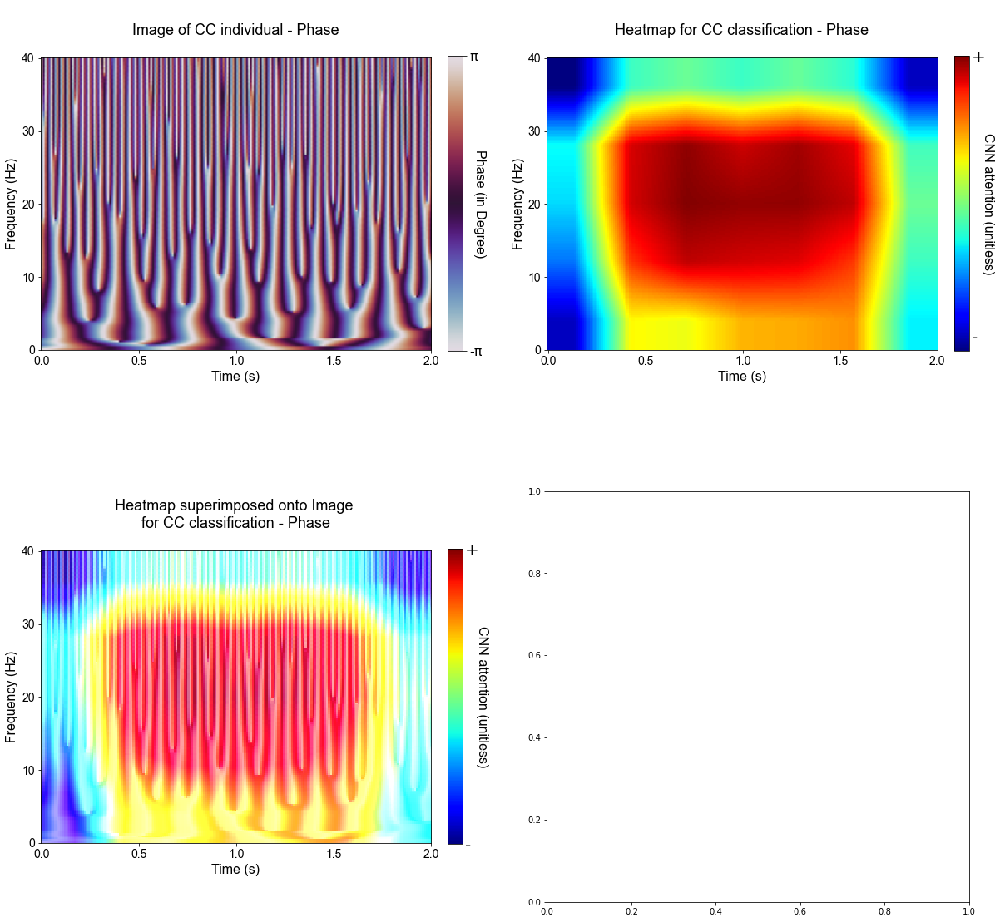

In [13]:
# Import relevant libraries
import matplotlib
import matplotlib.font_manager
import matplotlib.colors as colors
import cv2
from tf_explain.core.grad_cam import GradCAM

# Set font to Arial
hfont = {'fontname':'Arial'}

##################
#### Grad-CAM ####
##################

# Choose random picture to visualize
no = np.random.randint(len(p8_test_pics), size=1)[0]
data = (np.expand_dims(p8_test_pics[no],axis=0),test_targets[no])

# Instantiate GradCAM
explainer = GradCAM()

# Set the last layer to None to help visualization 
#(recommended here: https://github.com/sicara/tf-explain/issues/54)
model = tf.keras.models.clone_model(viz_model)
model.layers[-1].activation = None

# Use GradCAM at the last conv layer. 
# Image weight determines how much one sees the image, with 0 only showing the heatmap without the underlying image.
# Image weight is adapted depening on whether Phase or Power is plotted, as the magma colormap interferes more with the JET heatmap 
grid = explainer.explain(
    data, model, class_index = 0, layer_name=last_conv_layer_name, image_weight = 0.75 if angle else 0.5, use_guided_grads = True, colormap=cv2.COLORMAP_JET
)

grid_pure = explainer.explain(
    data, model, class_index = 0, layer_name=last_conv_layer_name, image_weight = 0 if angle else 0.5, use_guided_grads = True, colormap=cv2.COLORMAP_JET
)

#######################
#### Visualization ####
#######################

classlabel = "CC" if test_targets[no] == 1 else "DC"

# Display Image
fig, ax = plt.subplots(2, 2, figsize = (20,20))
image = ax[0,0].imshow(np.squeeze(data[0]), cmap = 'twilight' if angle == True else 'magma' ) # store this ax object to pass it to the colorbar later
ax[0,0].imshow(np.squeeze(data[0]))
ax[0,0].set_title("\nImage of %s individual - %s\n"%(classlabel, print_domain),**hfont, size = 18)
ax[0,0].set_yticks(np.linspace(0,149.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0,0].set_yticklabels([round(i) for i in np.linspace(40,0,5)],**hfont, size = 14)
ax[0,0].set_xticks(np.linspace(0,199.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0,0].set_xticklabels(np.linspace(0,2,5), **hfont, size = 14)
ax[0,0].tick_params(axis="x", bottom=True, top = False, labelbottom=True, labeltop=False)
ax[0,0].set_xlabel("Time (s)", **hfont, size = 16)
ax[0,0].set_ylabel("Frequency (Hz)", **hfont, size = 16)

#Customize Colorbar
cbar_0 = plt.colorbar(image, ax = ax[0,0],fraction=0.035, pad=0.04, ticks = [np.squeeze(data[0]).min(),np.squeeze(data[0]).max()])
cbar_0.ax.tick_params(size = 5, labelsize=16) 
# Adapt caption of colorbar depending on whether Phase or Power is plotted
if angle:
    cbar_0.ax.set_ylabel('Phase (in Degree)\n\n\n', fontsize = 16, rotation=270, **hfont)
    cbar_0.ax.set_yticklabels(['-π', 'π'])
else:
    cbar_0.ax.set_ylabel('Power (rescaled)\n\n\n', fontsize = 16, rotation=270, **hfont)
    cbar_0.ax.set_yticklabels(['0', '1'])
    

# Display Heatmap
mat = ax[0,1].matshow(grid_pure, cmap = 'jet') # store this ax object to pass it to the colorbar later
ax[0,1].matshow(grid_pure)
ax[0,1].set_title("Heatmap for %s classification - %s\n"%(classlabel, print_domain),**hfont, size = 18)
ax[0,1].set_yticks(np.linspace(0,149.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0,1].set_yticklabels([round(i) for i in np.linspace(40,0,5)],**hfont, size = 14)
ax[0,1].set_xticks(np.linspace(0,199.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0,1].set_xticklabels(np.linspace(0,2,5), **hfont, size = 14)
ax[0,1].tick_params(axis="x", bottom=True, top = False, labelbottom=True, labeltop=False)
ax[0,1].set_xlabel("Time (s)", **hfont, size = 16)
ax[0,1].set_ylabel("Frequency (Hz)", **hfont, size = 16)

# Customize Colorbar
cbar_1 = plt.colorbar(mat, ax = ax[0,1],fraction=0.035, pad=0.04, ticks = [grid.min(),grid.max()])
cbar_1.ax.tick_params(size = 0, labelsize=20) 
cbar_1.ax.set_ylabel('CNN attention (unitless)\n\n\n', fontsize = 16, rotation=270,**hfont)
cbar_1.ax.set_yticklabels(['- ', '+ '])

# Display Heatmap
mat = ax[1,0].matshow(grid, cmap = 'jet') # store this ax object to pass it to the colorbar later
ax[1,0].matshow(grid)
ax[1,0].set_title("Heatmap superimposed onto Image \nfor %s classification - %s\n"%(classlabel, print_domain),**hfont, size = 18)
ax[1,0].set_yticks(np.linspace(0,149.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[1,0].set_yticklabels([round(i) for i in np.linspace(40,0,5)],**hfont, size = 14)
ax[1,0].set_xticks(np.linspace(0,199.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[1,0].set_xticklabels(np.linspace(0,2,5), **hfont, size = 14)
ax[1,0].tick_params(axis="x", bottom=True, top = False, labelbottom=True, labeltop=False)
ax[1,0].set_xlabel("Time (s)", **hfont, size = 16)
ax[1,0].set_ylabel("Frequency (Hz)", **hfont, size = 16)

# Customize Colorbar
cbar_2 = plt.colorbar(mat, ax = ax[1,0],fraction=0.035, pad=0.04, ticks = [grid.min(),grid.max()])
cbar_2.ax.tick_params(size = 0, labelsize=20) 
cbar_2.ax.set_ylabel('CNN attention (unitless)\n\n\n', fontsize = 16, rotation=270,**hfont)
cbar_2.ax.set_yticklabels(['- ', '+ '])

#plt.tight_layout()
plt.show()

## Class-wise Heatmaps

In [ ]:
#####################################
#### Compute class-wise heatmaps ####
#####################################

# Define function to retrieve the GradCAM heatmaps for all members of one class
def heatmaps_per_class(viz_model, test_images, test_target, target):
    
    # List comprehension: select those images where test_targets == target
    subset = [test_images[i] for i in np.where(test_targets == target)[0]]

    # Instantiate an empty array to store heatmaps in, with length of the respective subset as first dimension, and shape of the heatmap as the other dimensions.
    heatmap_array = np.empty(shape = (len(subset),150, 200, 3), dtype = "uint8")

    for i in range(len(subset)):
        data = (np.expand_dims(subset[i],axis=0),target) #Format data to GradCAM-readable format

        # Instantiate GradCAM
        explainer = GradCAM()

        # Set the last layer to None to help visualization 
        #(recommended here: https://github.com/sicara/tf-explain/issues/54)
        model = tf.keras.models.clone_model(viz_model)
        model.layers[-1].activation = None

        # Use GradCAM at the last conv layer. Image weight determines how much one sees the image, with 0 only showing hte heatmap without the underlying image. 
        heatmap = explainer.explain(
            data, model, class_index = 0, layer_name=last_conv_layer_name, image_weight = 0, use_guided_grads = True, colormap=cv2.COLORMAP_JET
        )

        heatmap_array[i,:,:] = heatmap
    
    return(heatmap_array)

# Call functions
heatmaps_cc = heatmaps_per_class(viz_model, p8_test_pics, test_targets, target = 1) #Target = 1 for CC
heatmaps_dc = heatmaps_per_class(viz_model, p8_test_pics, test_targets, target = 0) # Target = 0 for DC

# Save mean heatmaps
with open("Predictions/mean_heatmaps_cc_5%s%s.pkl"%(domain, condition),"wb") as f:
    pickle.dump(heatmaps_cc, f)

with open("Predictions/mean_heatmaps_dc_5%s%s.pkl"%(domain, condition),"wb") as f:
    pickle.dump(heatmaps_dc, f)
    

In [ ]:
#######################
#### Visualization ####
#######################

# Manually truncate colormap to fit the colorscale in the mean heatmaps
# Function adapted from Stack Overflow: https://stackoverflow.com/questions/18926031
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap


# Plot mean heatmaps
mean_cc = np.mean(heatmaps_cc, axis = 0).astype(int) # Average over first dimension, i.e., over all heatmaps
mean_dc = np.mean(heatmaps_dc, axis = 0).astype(int)

new_cmap = truncate_colormap(plt.get_cmap('jet'), mean_cc.min() / 255, mean_cc.max() / 255)

fig, ax = plt.subplots(1,2, figsize = (20,10))
mat_0 = ax[0].matshow(mean_cc,cmap = new_cmap) # store this ax object to pass it to the colorbar later
ax[0].matshow(mean_cc) 
ax[0].set_title("\nMean heatmap for CC individuals - %s\n"%print_domain, **hfont, size = 18)
ax[0].set_yticks(np.linspace(0,149.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0].set_yticklabels([round(i) for i in np.linspace(40,0,5)],**hfont, size = 14)
ax[0].set_xticks(np.linspace(0,199.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[0].set_xticklabels(np.linspace(0,2,5), **hfont, size = 14)
ax[0].tick_params(axis="x", bottom=True, top = False, labelbottom=True, labeltop=False)
ax[0].set_xlabel("Time (s)", **hfont, size = 16)
ax[0].set_ylabel("Frequency (Hz)", **hfont, size = 16)

mat_1 = ax[1].matshow(mean_dc,cmap = new_cmap) # store this ax object to pass it to the colorbar later
ax[1].matshow(mean_dc) 
ax[1].set_title("\nMean heatmap for DC individuals - %s\n"%print_domain,**hfont, size = 18)
ax[1].set_yticks(np.linspace(0,149.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[1].set_yticklabels([round(i) for i in np.linspace(40,0,5)],**hfont, size = 14)
ax[1].set_xticks(np.linspace(0,199.5,5), rotation = 45) # Subtract 0.5 from linspace end such that axis don't get streched
ax[1].set_xticklabels(np.linspace(0,2,5), **hfont, size = 14)
ax[1].tick_params(axis="x", bottom=True, top = False, labelbottom=True, labeltop=False)
ax[1].set_xlabel("Time (s)", **hfont, size = 16)
ax[1].set_ylabel("Frequency (Hz)", **hfont, size = 16)


# Add colorbars
cbar_0 = plt.colorbar(mat_0, ax = ax[0],fraction=0.035, pad=0.04, ticks = [mean_cc.min(),mean_cc.max()])
cbar_0.ax.tick_params(size = 0, labelsize=20) 
cbar_0.ax.set_ylabel('CNN attention (unitless)', fontsize = 16, rotation=270,**hfont)
cbar_0.ax.set_yticklabels(['- ', ' + '])

cbar_1 = plt.colorbar(mat_1, ax = ax[1],fraction=0.035, pad=0.04, ticks = [mean_dc.min(),mean_dc.max()])
cbar_1.ax.tick_params(size = 0, labelsize=20) 
cbar_1.ax.set_ylabel('CNN attention (unitless)', fontsize = 16, rotation=270,**hfont)
cbar_1.ax.set_yticklabels(['- ', ' + '])

plt.show()

## Lucid

The following code serves to investigate which images activate which layers the most. In the examples below, the feature maps that activate the last convolutional layer most are displayed for several Lucid parameter settings.

In [ ]:
# Load best Model from Training procedure
viz_model = keras.models.load_model('Models/ResNet_bestmodel_{}{}.h5'.format(domain, condition))

# Get the name of the last convolutional layer
for layer in viz_model.layers[::-1]: # Iterate through reversed layers
    if 'conv' in layer.name: # The name of the first (i.e., last, due to layer reversal) layer to contain "conv" in name breaks the loop 
        last_conv_layer_name = layer.name
        break

Step 200


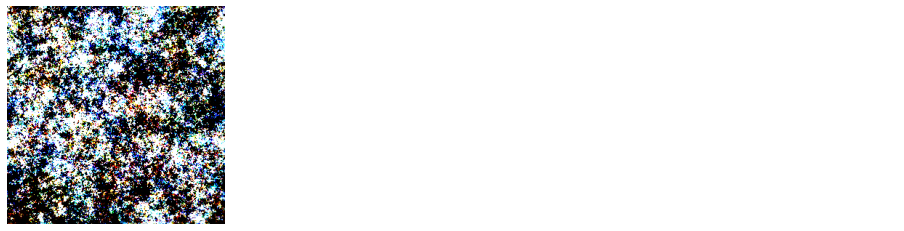

In [14]:
# Symmetrical image size not needed because ResNet and Inception allow variable image size

IMAGE_SIZE = 300
obj = objectives.Channel(viz_model, last_conv_layer_name, 29)
obj_reg = obj - objectives.TotalVar() * 100
_ = render.render_vis(obj_reg, IMAGE_SIZE, freq_decay=0.9, transforms=[lambda x: x], steps = [200])


### Trying different parameter combinations of Lucid

The results are visualized in a grid of images. The fist cell derives the Lucid map for every parameter combination in the grid, the second cell visualizes it in a large plot with numerous subplots

Step 200


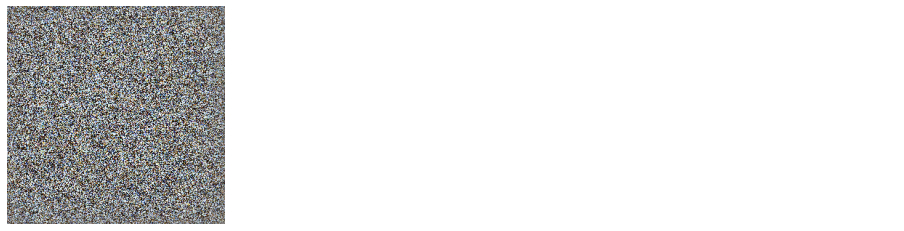

Penalty on variance: 1, Frequency decay: 0.0
Step 200


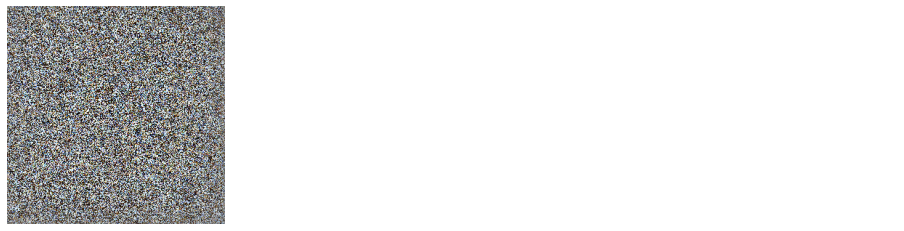

Penalty on variance: 10, Frequency decay: 0.0
Step 200


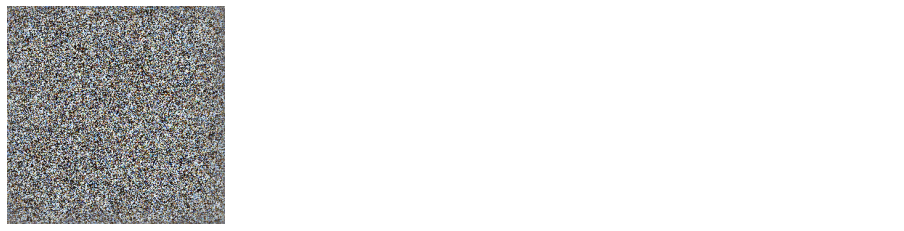

Penalty on variance: 100, Frequency decay: 0.0
Step 200


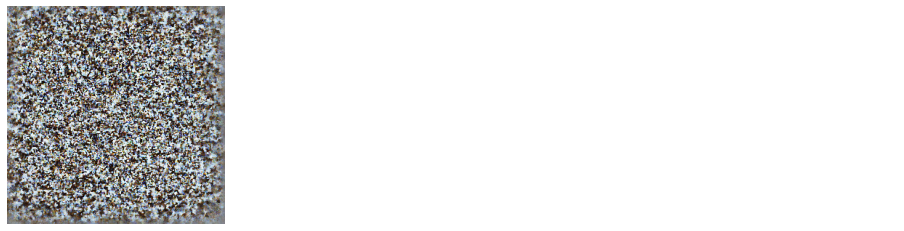

Penalty on variance: 1000, Frequency decay: 0.0
Step 200


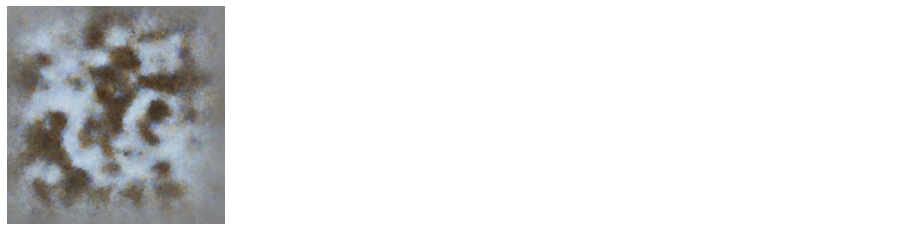

Penalty on variance: 10000, Frequency decay: 0.0
Step 200


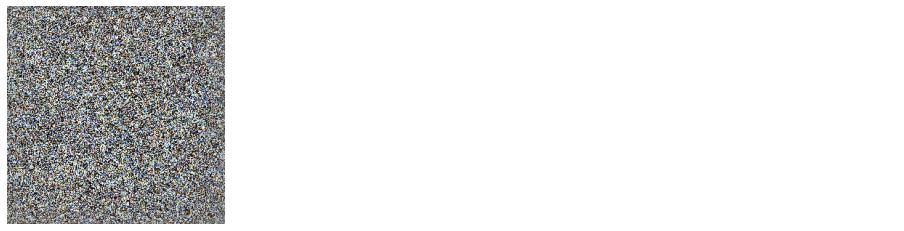

Penalty on variance: 1, Frequency decay: 0.1
Step 200


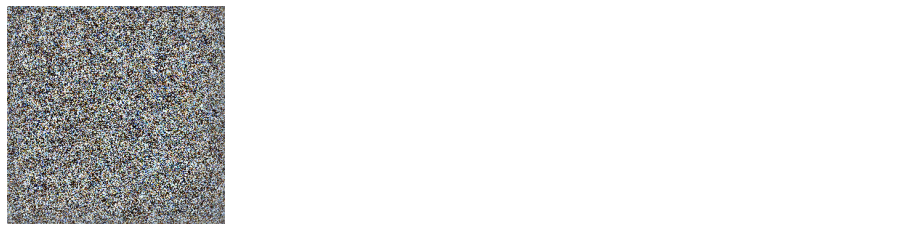

Penalty on variance: 10, Frequency decay: 0.1
Step 200


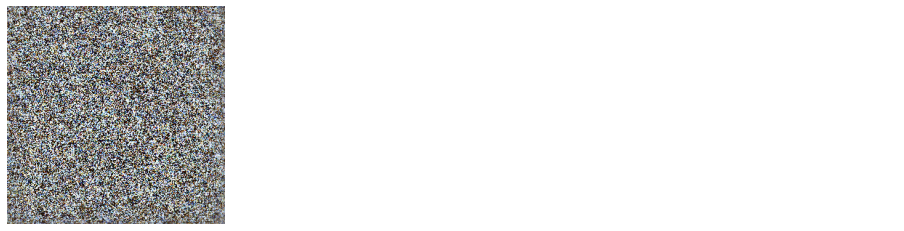

Penalty on variance: 100, Frequency decay: 0.1
Step 200


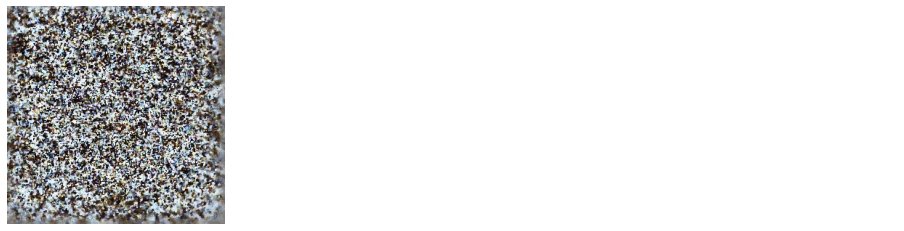

Penalty on variance: 1000, Frequency decay: 0.1
Step 200


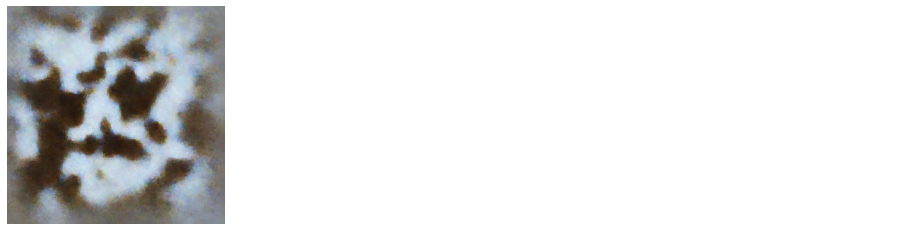

Penalty on variance: 10000, Frequency decay: 0.1
Step 200


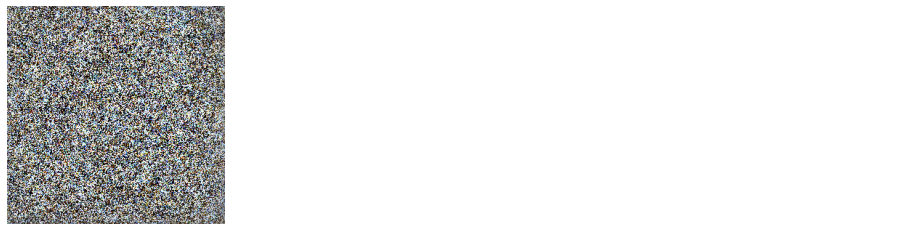

Penalty on variance: 1, Frequency decay: 0.2
Step 200


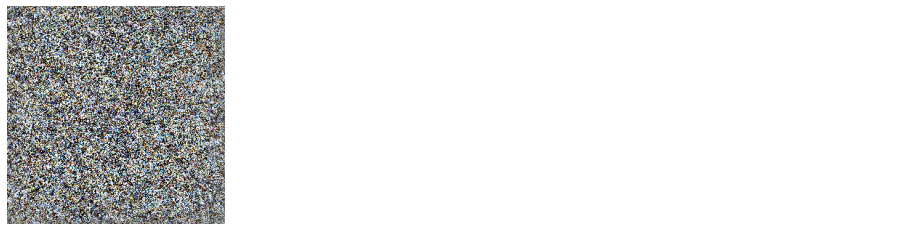

Penalty on variance: 10, Frequency decay: 0.2
Step 200


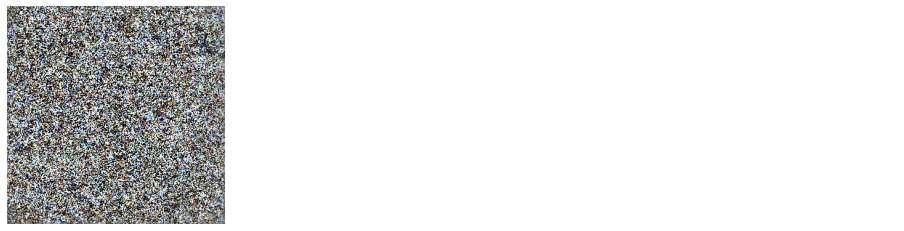

Penalty on variance: 100, Frequency decay: 0.2
Step 200


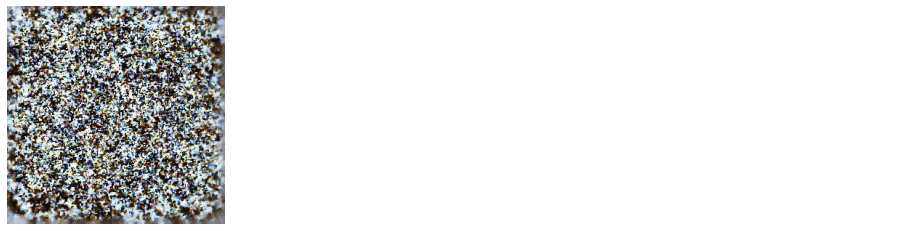

Penalty on variance: 1000, Frequency decay: 0.2
Step 200


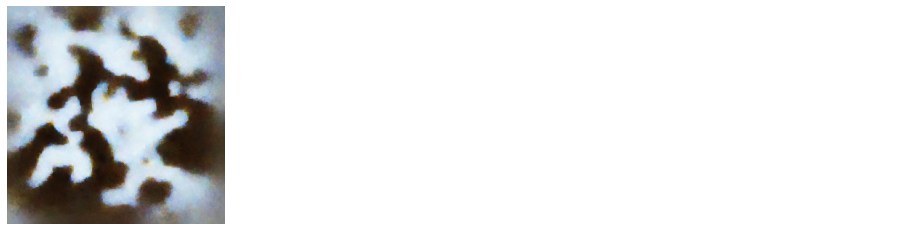

Penalty on variance: 10000, Frequency decay: 0.2
Step 200


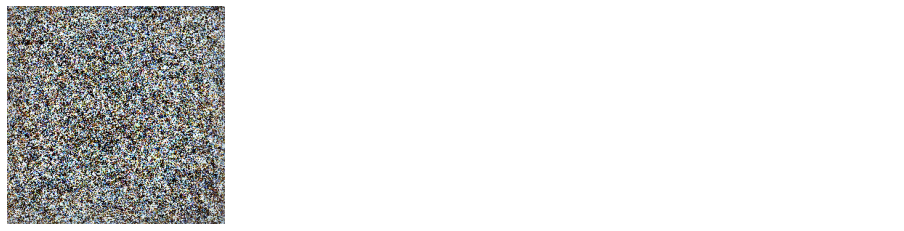

Penalty on variance: 1, Frequency decay: 0.30000000000000004
Step 200


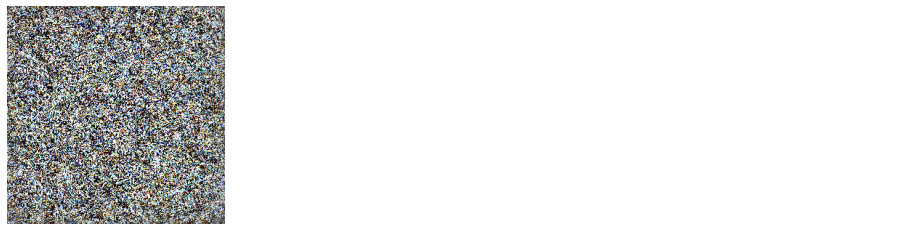

Penalty on variance: 10, Frequency decay: 0.30000000000000004
Step 200


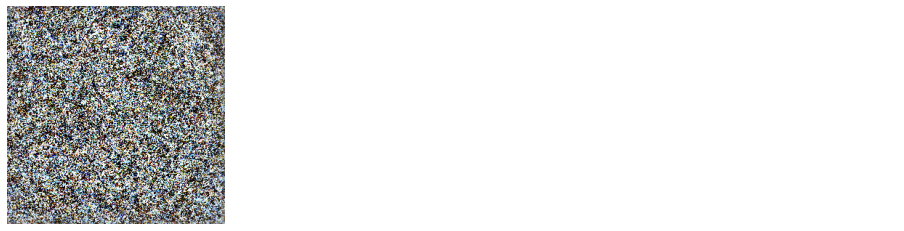

Penalty on variance: 100, Frequency decay: 0.30000000000000004
Step 200


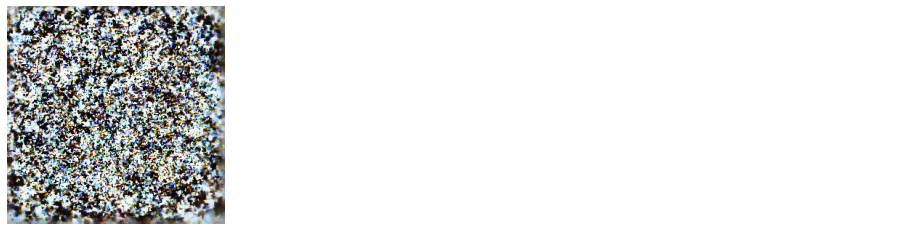

Penalty on variance: 1000, Frequency decay: 0.30000000000000004
Step 200


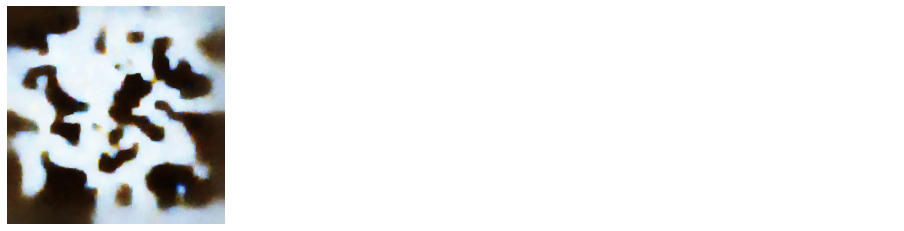

Penalty on variance: 10000, Frequency decay: 0.30000000000000004
Step 200


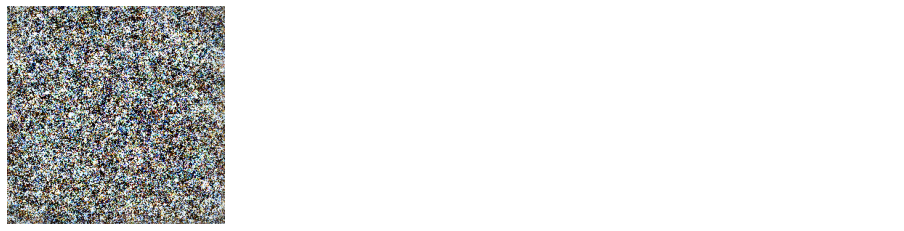

Penalty on variance: 1, Frequency decay: 0.4
Step 200


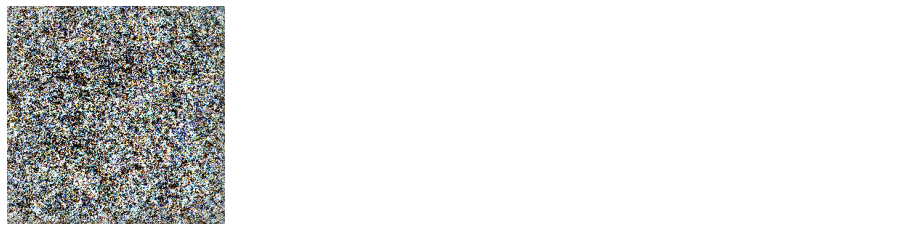

Penalty on variance: 10, Frequency decay: 0.4
Step 200


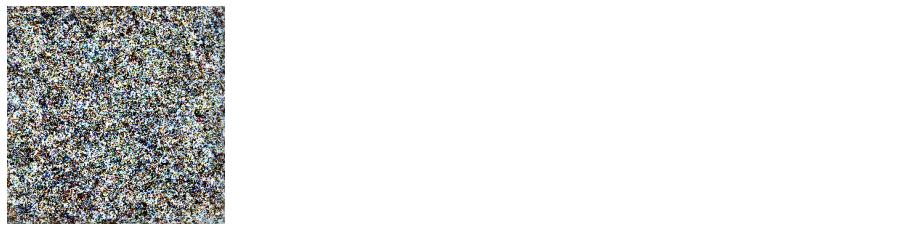

Penalty on variance: 100, Frequency decay: 0.4
Step 200


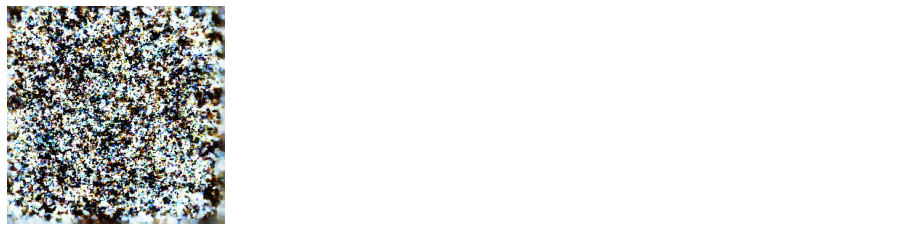

Penalty on variance: 1000, Frequency decay: 0.4
Step 200


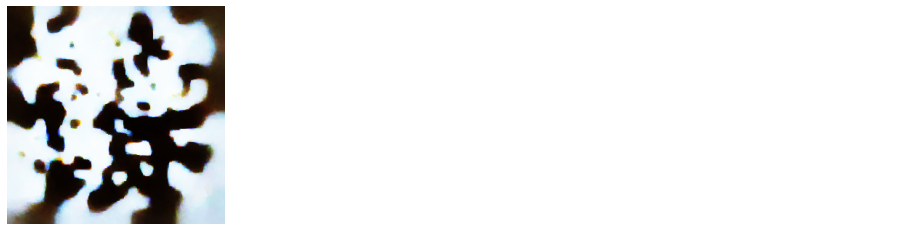

Penalty on variance: 10000, Frequency decay: 0.4
Step 200


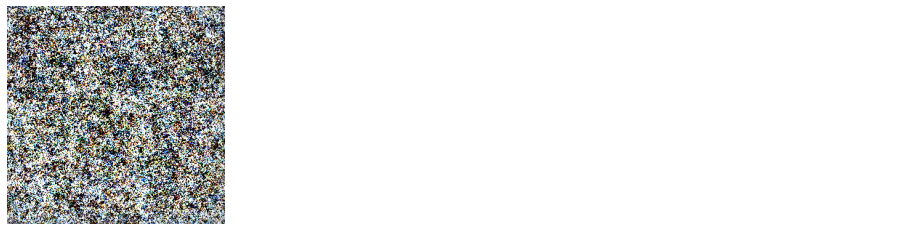

Penalty on variance: 1, Frequency decay: 0.5
Step 200


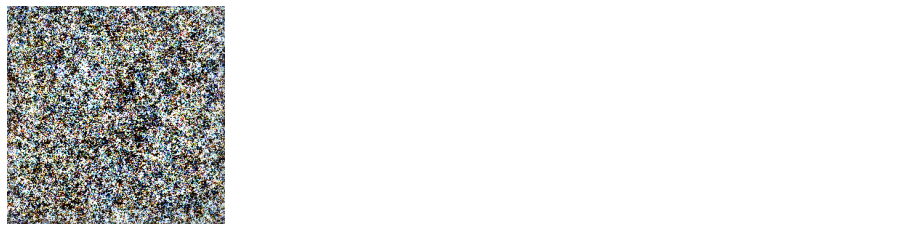

Penalty on variance: 10, Frequency decay: 0.5
Step 200


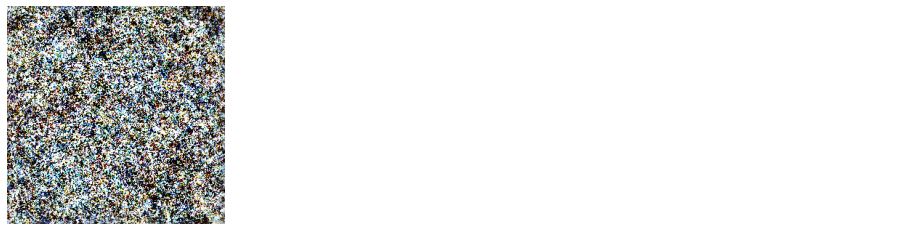

Penalty on variance: 100, Frequency decay: 0.5
Step 200


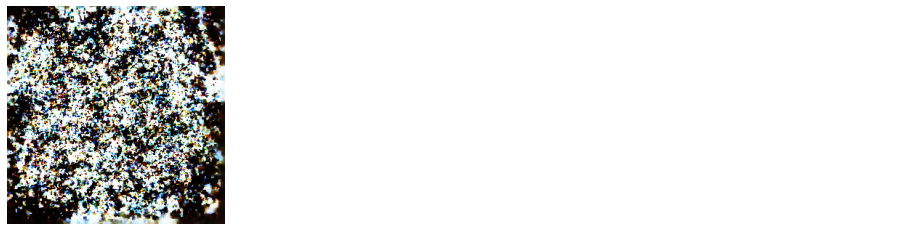

Penalty on variance: 1000, Frequency decay: 0.5
Step 200


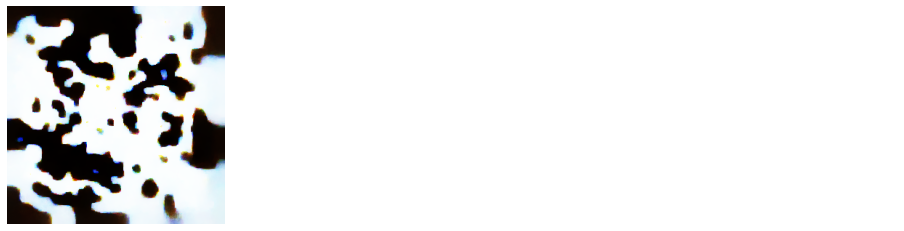

Penalty on variance: 10000, Frequency decay: 0.5
Step 200


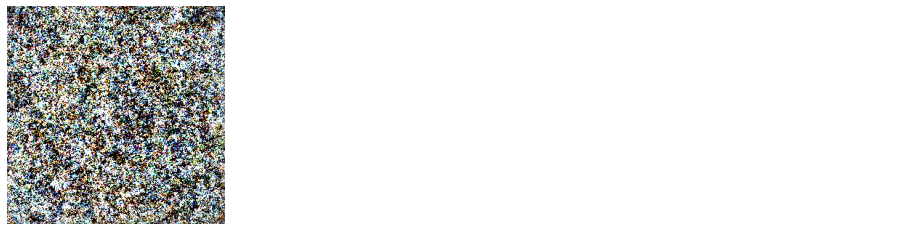

Penalty on variance: 1, Frequency decay: 0.6000000000000001
Step 200


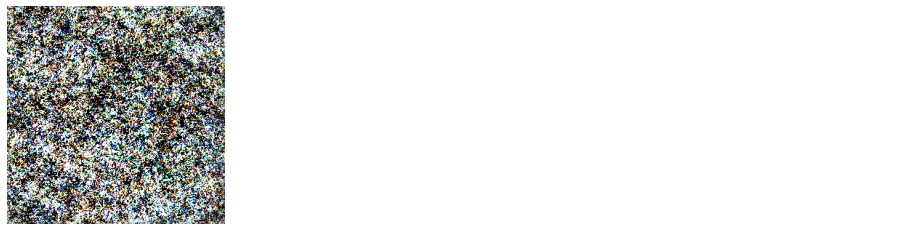

Penalty on variance: 10, Frequency decay: 0.6000000000000001
Step 200


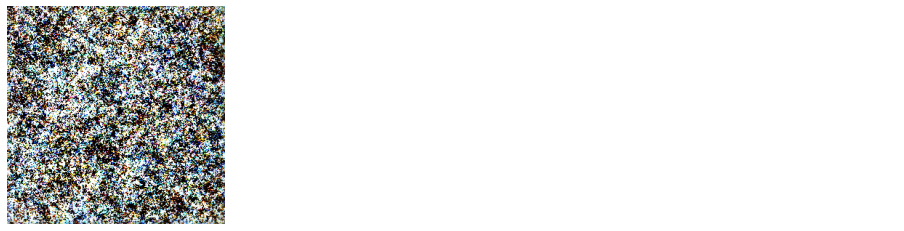

Penalty on variance: 100, Frequency decay: 0.6000000000000001
Step 200


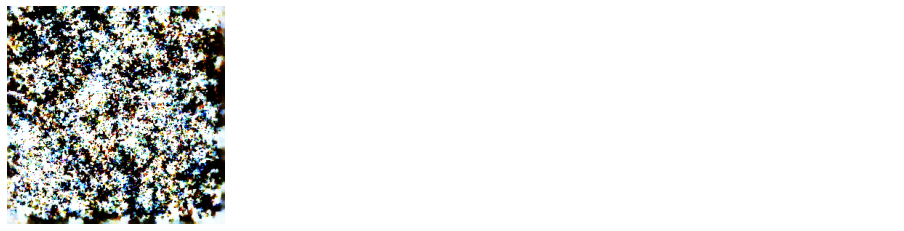

Penalty on variance: 1000, Frequency decay: 0.6000000000000001
Step 200


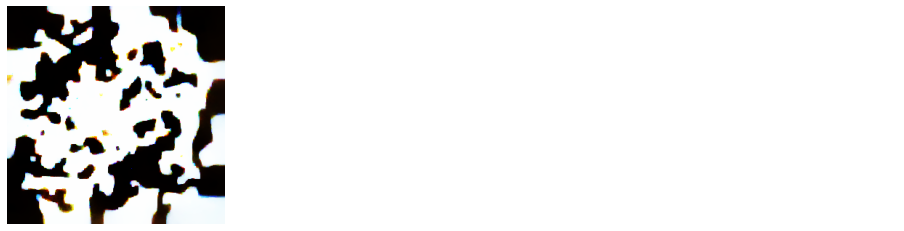

Penalty on variance: 10000, Frequency decay: 0.6000000000000001
Step 200


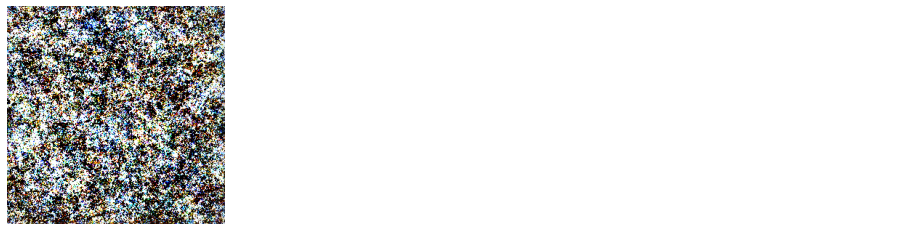

Penalty on variance: 1, Frequency decay: 0.7000000000000001
Step 200


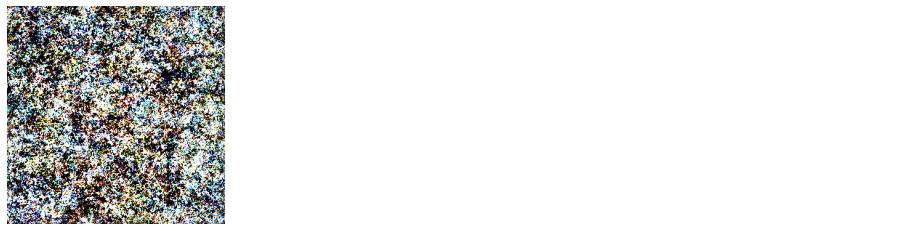

Penalty on variance: 10, Frequency decay: 0.7000000000000001
Step 200


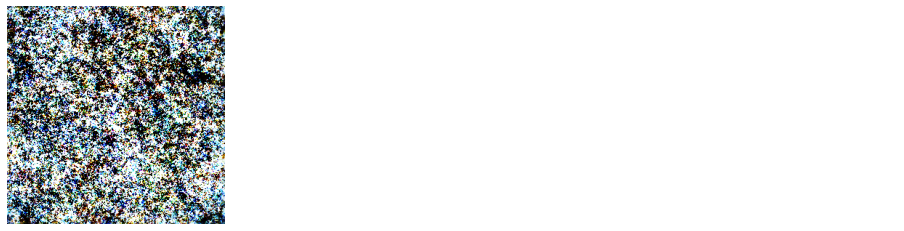

Penalty on variance: 100, Frequency decay: 0.7000000000000001
Step 200


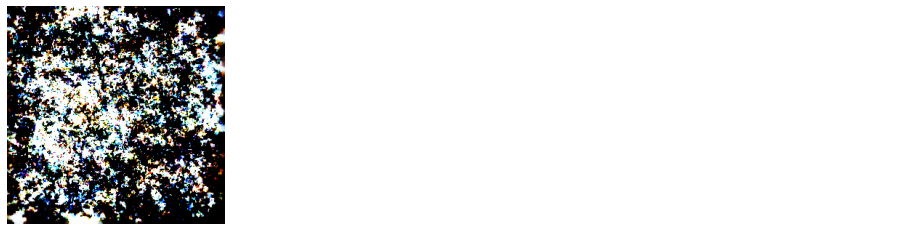

Penalty on variance: 1000, Frequency decay: 0.7000000000000001
Step 200


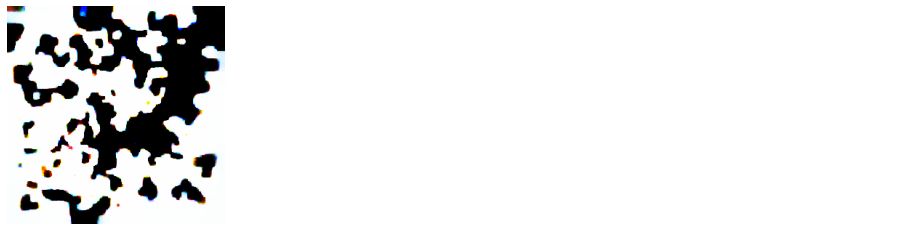

Penalty on variance: 10000, Frequency decay: 0.7000000000000001
Step 200


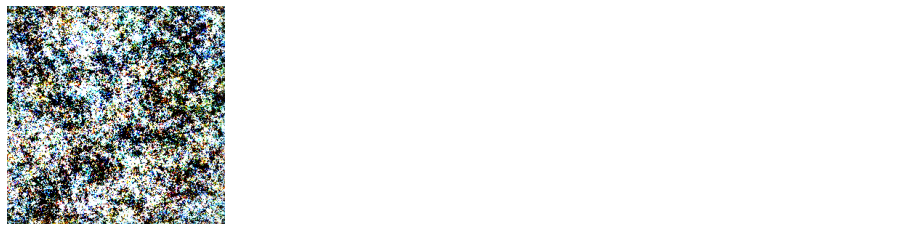

Penalty on variance: 1, Frequency decay: 0.8
Step 200


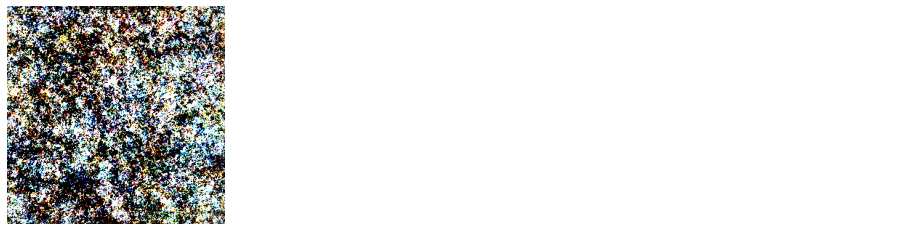

Penalty on variance: 10, Frequency decay: 0.8
Step 200


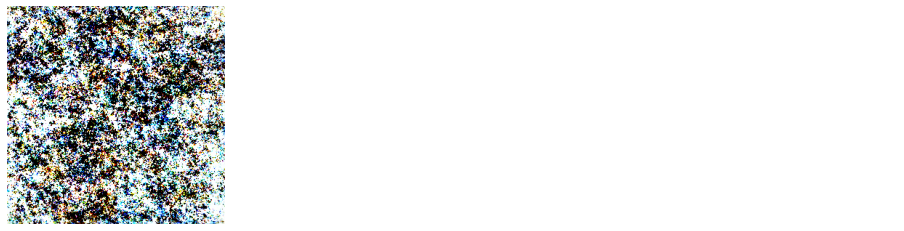

Penalty on variance: 100, Frequency decay: 0.8
Step 200


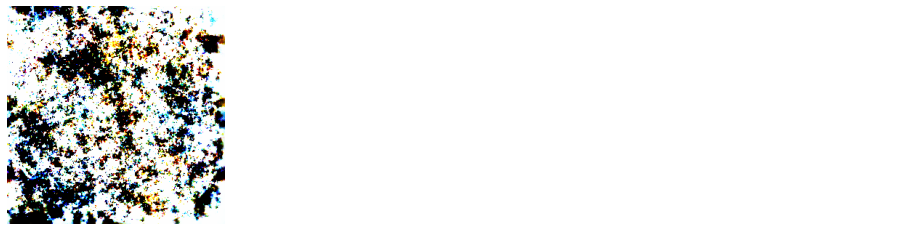

Penalty on variance: 1000, Frequency decay: 0.8
Step 200


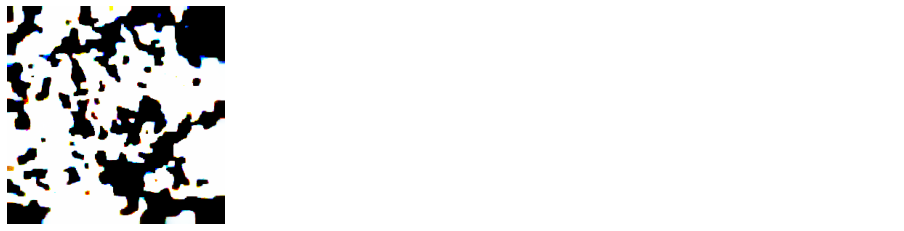

Penalty on variance: 10000, Frequency decay: 0.8
Step 200


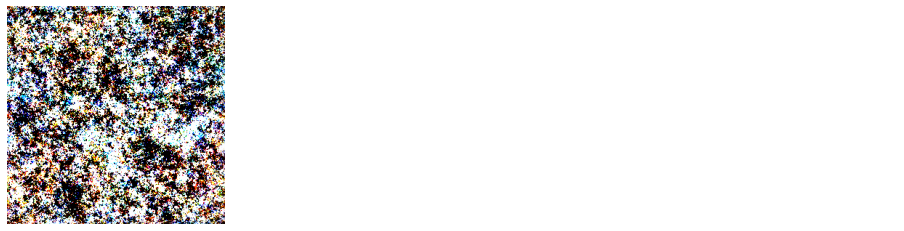

Penalty on variance: 1, Frequency decay: 0.9
Step 200


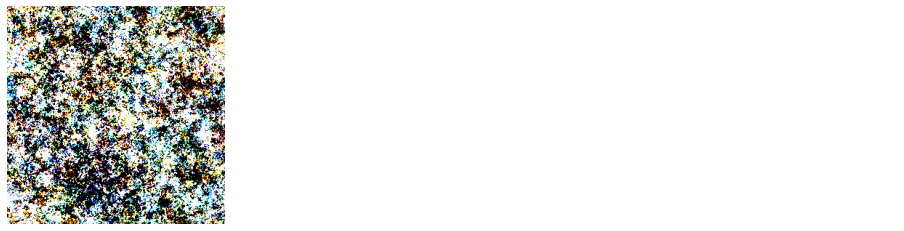

Penalty on variance: 10, Frequency decay: 0.9
Step 200


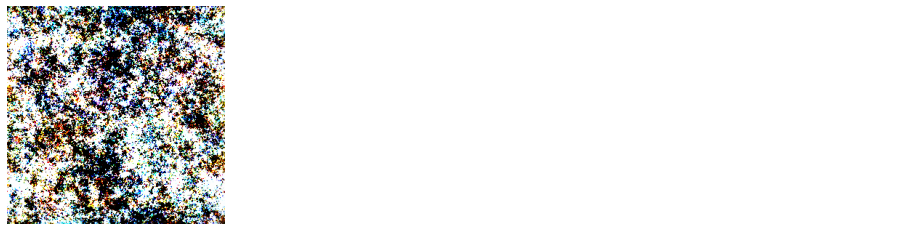

Penalty on variance: 100, Frequency decay: 0.9
Step 200


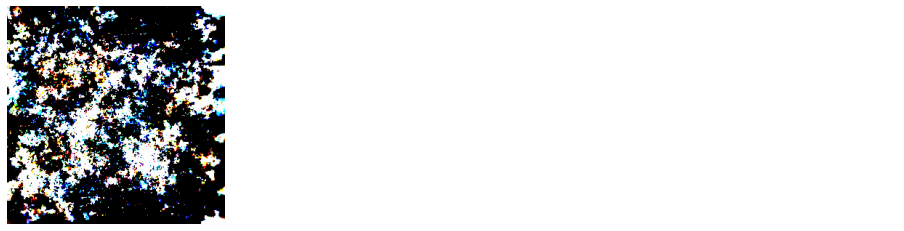

Penalty on variance: 1000, Frequency decay: 0.9
Step 200


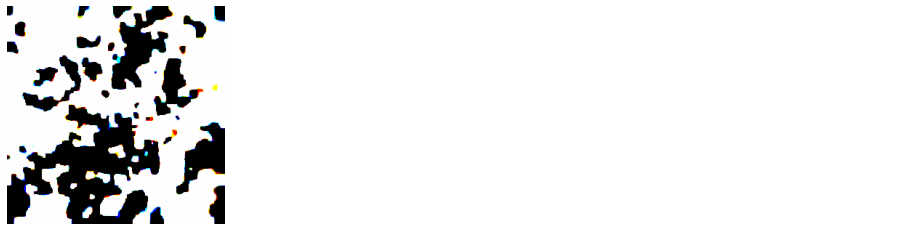

Penalty on variance: 10000, Frequency decay: 0.9


In [15]:
from sklearn.model_selection import ParameterGrid

# Define objective layer and image size
IMAGE_SIZE = 300
obj = objectives.Channel(viz_model, last_conv_layer_name, 27)

# define search space
var_penalties = [1,10,100,1000,10000]
freq_decay = np.linspace(0,0.9,10)
param_grid = ParameterGrid({"var_penalty": var_penalties, "freq_decay": freq_decay})

map_list = []
# Run Lucid for every param combination
for grid_vals in param_grid:
    obj_reg = obj - objectives.TotalVar() * grid_vals["var_penalty"]
    _ = render.render_vis(obj_reg, IMAGE_SIZE, freq_decay=grid_vals["freq_decay"],transforms=[lambda x: x], display_plots = False)
    map_list.append(_)
    print("Penalty on variance: {}, Frequency decay: {}".format(grid_vals["var_penalty"], grid_vals["freq_decay"]))


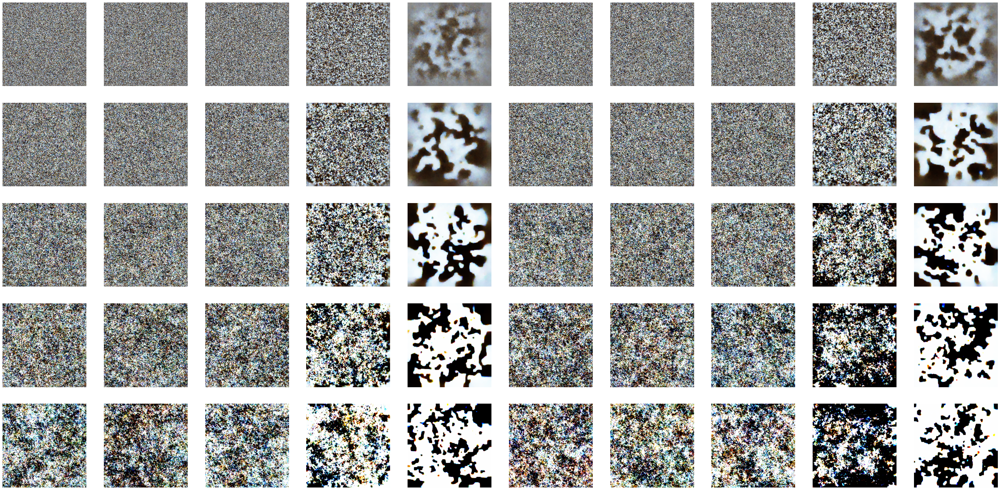

In [21]:
IMAGE_SIZE = 300


fig, ax = plt.subplots(5,10, figsize = (50,25))

i,r = 0,0
for feature_map in map_list:
    ax[r,i].imshow(np.squeeze(feature_map))
    ax[r,i].axis('off')
    
    i += 1
    if i == 10:
        r += 1
        i = 0

plt.show()